In [1]:
### Imports
import cv2
import openslide
import pandas as pd
from io import StringIO
import numpy as np

In [69]:
### parameters
HES_SLIDE_PATH = "C:/Users/manon/Desktop/data_CHU/bloc/25P7216_6_1_HES.mrxs" 
IHC_SLIDE_PATH = "C:/Users/manon/Desktop/data_CHU/bloc/25P7216_6_2_IHC.mrxs"

HES_COORDINATES = "C:/Users/manon/Desktop/data_CHU/bloc/25P7216_6_1_HES-points.tsv"
IHC_COORDINATES = "C:/Users/manon/Desktop/data_CHU/bloc/25P7216_6_2_IHC-points.tsv"

WORKING_LEVEL = 3


## Pre requisites - Check slides

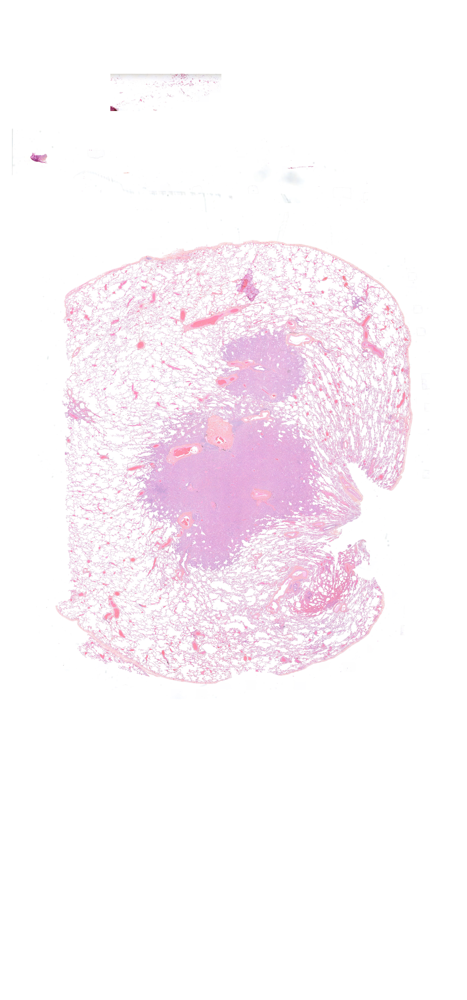

In [10]:
hes_slide = openslide.OpenSlide(HES_SLIDE_PATH)
hes_thumb = openslide.OpenSlide.get_thumbnail(hes_slide,(4000,4000))
hes_thumb

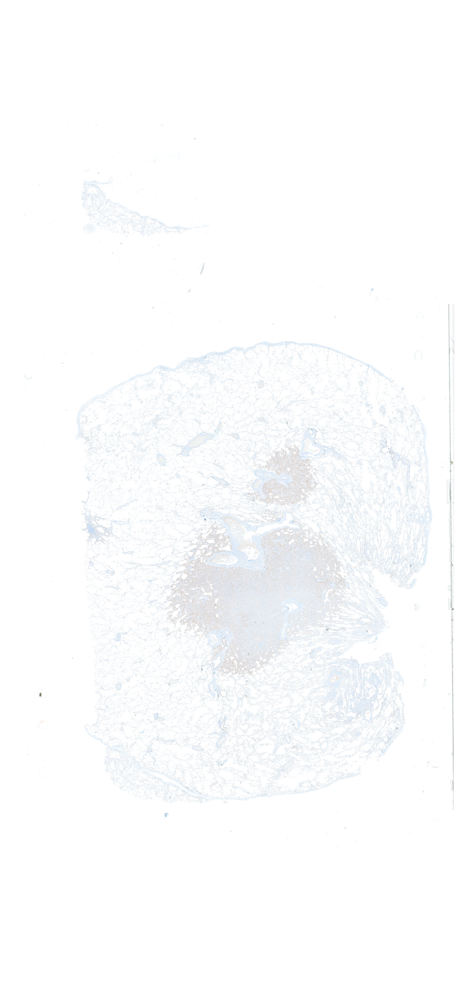

In [ ]:
ihc_slide = openslide.OpenSlide(IHC_SLIDE_PATH)
ihc_thumb = openslide.OpenSlide.get_thumbnail(ihc_slide,(4000,4000))
ihc_thumb

In [7]:
with open(HES_COORDINATES, 'rb') as f:
  contents_b = f.read().decode("utf-8")
df = pd.read_csv(StringIO(contents_b), sep="\t")
hes_coords = df[['x','y']]
hes_coords

,x,y
0,30546.392855,41095.348879
1,10105.204503,120071.366052
2,85727.927205,94153.357679
3,36597.818604,136891.458910


In [8]:
with open(IHC_COORDINATES, 'rb') as f:
  contents_b = f.read().decode("utf-8")
df = pd.read_csv(StringIO(contents_b), sep="\t")
ihc_coords = df[['x','y']]
ihc_coords


,x,y
0,30932.628077,55528.170904
1,14048.200506,136855.223740
2,87806.662306,105963.320301
3,48854.798826,153778.124052


## Chose right Slide level and scale coordinates for IHC and HES

In [70]:
import openslide

he_slide = openslide.OpenSlide(HES_SLIDE_PATH)

print("Number of levels:", he_slide.level_count)

for level in range(he_slide.level_count):
    print(
        f"Level {level}:",
        "dimensions =", he_slide.level_dimensions[level],
        "downsample =", he_slide.level_downsamples[level]
    )


Number of levels: 10
Level 0: dimensions = (105472, 225792) downsample = 1.0
Level 1: dimensions = (52736, 112896) downsample = 2.0
Level 2: dimensions = (26368, 56448) downsample = 4.0
Level 3: dimensions = (13184, 28224) downsample = 8.0
Level 4: dimensions = (6592, 14112) downsample = 16.0
Level 5: dimensions = (3296, 7056) downsample = 32.0
Level 6: dimensions = (1648, 3528) downsample = 64.0
Level 7: dimensions = (824, 1764) downsample = 128.0
Level 8: dimensions = (412, 882) downsample = 256.0
Level 9: dimensions = (206, 441) downsample = 512.0


In [71]:
he_bounds_x = int(he_slide.properties.get("openslide.bounds-x", 0))
he_bounds_y = int(he_slide.properties.get("openslide.bounds-y", 0))
he_bounds_x,he_bounds_y



(2560, 16640)

In [72]:
downsample = he_slide.level_downsamples[WORKING_LEVEL]
w,h = he_slide.level_dimensions[WORKING_LEVEL]
print(f"Downsample: {downsample} Image size (wxh):{w,h}")

Downsample: 8.0 Image size (wxh):(13184, 28224)


In [73]:
he_img = he_slide.read_region(
    location=(he_bounds_x, he_bounds_y),          # always in level-0 coordinates
    level=WORKING_LEVEL,
    size=(w, h)
)
he_img_array = np.asarray(he_img)

In [74]:
he_img_array = he_img_array[::3]

In [75]:
#Scale coordinates to chosen level
# hes_coords_scaled = (hes_coords - np.array([bounds_x, bounds_y])) / downsample
hes_coords_scaled = hes_coords/downsample
hes_coords_scaled

,x,y
0,3818.299107,5136.918610
1,1263.150563,15008.920757
2,10715.990901,11769.169710
3,4574.727326,17111.432364


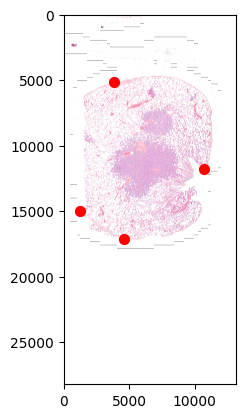

In [76]:
#check if points match
import matplotlib.pyplot as plt

plt.imshow(he_img)
plt.scatter(
    hes_coords_scaled['x'],
    hes_coords_scaled['y'],
    c="red",
    s=50
)
plt.show()


In [77]:
### IHC 
ihc_slide = openslide.OpenSlide(IHC_SLIDE_PATH)
w,h = ihc_slide.level_dimensions[WORKING_LEVEL]
ihc_bounds_x = int(ihc_slide.properties.get("openslide.bounds-x", 0))
ihc_bounds_y = int(ihc_slide.properties.get("openslide.bounds-y", 0))


ihc_img = ihc_slide.read_region(location=(ihc_bounds_x,ihc_bounds_y), level = WORKING_LEVEL,size =(w,h))



In [78]:
ihc_coords_scaled = ihc_coords/downsample

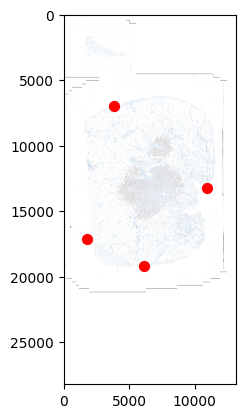

In [79]:
#check if points match
import matplotlib.pyplot as plt

plt.imshow(ihc_img)
plt.scatter(
    ihc_coords_scaled['x'],
    ihc_coords_scaled['y'],
    c="red",
    s=50
)
plt.show()


## Make Transform using CV2

In [80]:
dst_coords = np.copy(np.asanyarray(ihc_coords_scaled),order='C')
scr_coords = np.copy(np.asanyarray(hes_coords_scaled),order='C')

dst_coords.flags , scr_coords.flags

(  C_CONTIGUOUS : True
   F_CONTIGUOUS : False
   OWNDATA : True
   WRITEABLE : True
   ALIGNED : True
   WRITEBACKIFCOPY : False,
   C_CONTIGUOUS : True
   F_CONTIGUOUS : False
   OWNDATA : True
   WRITEABLE : True
   ALIGNED : True
   WRITEBACKIFCOPY : False)

In [81]:
T,inliers = cv2.estimateAffine2D(from_= scr_coords, to=dst_coords,)

T

array([[ 1.24497316e+00,  1.08441808e-01, -1.44415798e+03],
       [-1.28993442e-02,  1.02643017e+00,  1.71758697e+03]])

In [82]:
A = T[:, :2]   # 2×2 linear part
t = T[:, 2]  


In [83]:
theta_rad = np.arctan2(A[1, 0], A[0, 0])
theta_deg = np.degrees(theta_rad)
theta_deg

np.float64(-0.5936284872156712)

### Transform

In [84]:
h_dst, w_dst = np.asanyarray(ihc_img).shape[:2]
h_dst,w_dst


(28224, 13184)

In [98]:
import cv2

img_src_warped = cv2.warpAffine(
    np.asanyarray(he_img),
    T,
    dsize=(w_dst, h_dst),
    flags=cv2.INTER_LINEAR,
    borderMode=cv2.BORDER_TRANSPARENT,
    borderValue=(0, 0, 0)
)


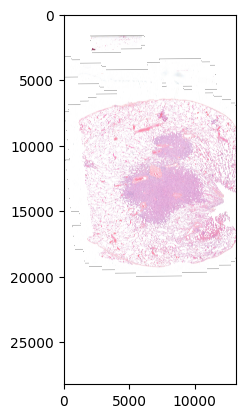

In [99]:
plt.imshow(img_src_warped)

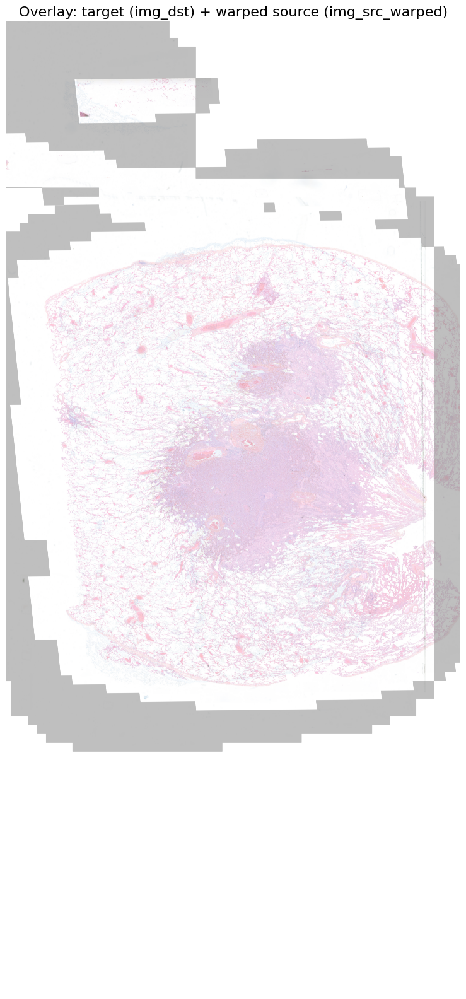

In [103]:
import matplotlib.pyplot as plt
import cv2
img_dst = np.asanyarray(ihc_img)
# --- Parameters ---
alpha = 0.5  # blending factor

# --- Safety checks ---
assert img_dst.shape == img_src_warped.shape, "Images must have same shape"
assert img_dst.dtype == img_src_warped.dtype, "Images must have same dtype"

# --- Alpha blending ---
overlay = cv2.addWeighted(img_dst, 0.5, img_src_warped, 0.5, 0)


# --- Display ---
plt.figure(figsize=(20, 20))  # BIG figure for WSI inspection
plt.imshow(overlay)
plt.axis("off")
plt.title("Overlay: target (img_dst) + warped source (img_src_warped)", fontsize=16)
plt.show()


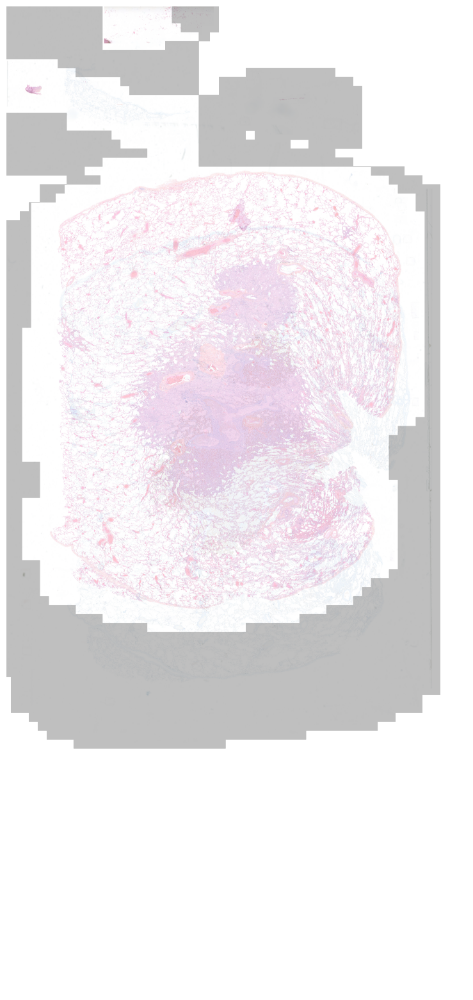

In [107]:
import numpy as np
import cv2  # OpenCV for resizing
import matplotlib.pyplot as plt

# Suppose img_a and img_b are your arrays
# img_a.shape -> (H, W, C)
# img_b.shape -> (h, w, c)

H, W = img_dst.shape[:2]

# Resize img_b to match img_a dimensions
img_b_resized = cv2.resize(he_img_array, (W, H))  # Resize to (width, height)

# If both are uint8 arrays (0-255), you can do a simple overlay using alpha
alpha = 0.5  # transparency factor: 0 = only img_a, 1 = only img_b
overlay = cv2.addWeighted(img_dst, 1-alpha, img_b_resized, alpha, 0)

# Show result
plt.figure(figsize=(20, 20))
plt.imshow(overlay)
plt.axis('off')
plt.show()
